# Proyecto Final - Modelos Computacionales I
### Aitana Orduña Lugo

In [96]:
import numpy as np 
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.io import loadmat
import networkx as nx
from matplotlib.animation import FuncAnimation, PillowWriter
from IPython.display import Image
from networkx.algorithms.community import greedy_modularity_communities
from mpl_toolkits.mplot3d import Axes3D
import scipy.io as sp

In [98]:
path = r"Coactivation_matrix.mat"
mat = loadmat(path)
cm = mat["Coactivation_matrix"]
coords = mat["Coord"]
x, y, z = coords[:, 0], coords[:, 1], coords[:, 2]

1. Definir grafos con la matriz estableciendo umbrales de coactivación de 0.08, 0.09 y 1, y graficar cada grafo. Añadir las coordenadas tridimensionales (incluidas en el archivo
.mat).


Conexiones para el grafo con umbral 0.08:
Conexión: x=[7.243636363636369, 7.986531986531986], y=[37.01090909090908, 46.22222222222223], z=[9.425454545454542, 15.609427609427613]
Conexión: x=[7.243636363636369, 7.55725190839695], y=[37.01090909090908, 33.8320610687023], z=[9.425454545454542, 23.511450381679396]
Conexión: x=[7.243636363636369, 8.902439024390247], y=[37.01090909090908, 36.1869918699187], z=[9.425454545454542, -0.31707317073170316]
Conexión: x=[7.243636363636369, 9.39776951672863], y=[37.01090909090908, 52.98141263940519], z=[9.425454545454542, 3.1524163568773247]
Conexión: x=[7.243636363636369, -3.418604651162795], y=[37.01090909090908, 39.92248062015503], z=[9.425454545454542, 10.170542635658919]
Conexión: x=[7.243636363636369, -4.538745387453872], y=[37.01090909090908, 46.53874538745387], z=[9.425454545454542, 3.06273062730628]
Conexión: x=[7.986531986531986, -5.00946372239747], y=[46.22222222222223, 50.466876971608826], z=[15.609427609427613, 19.671924290220815]
Conex

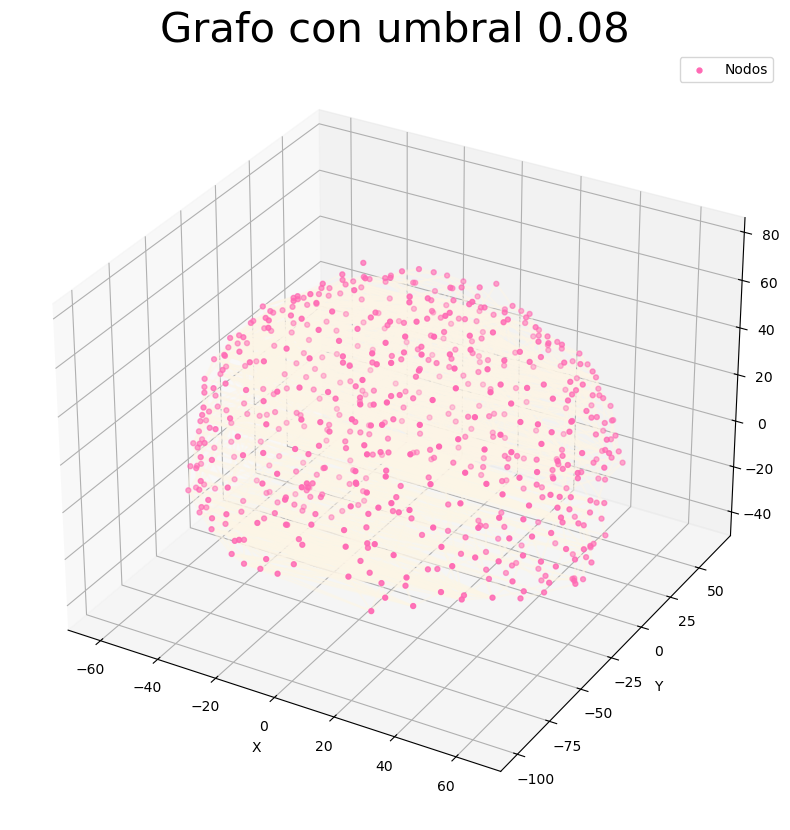

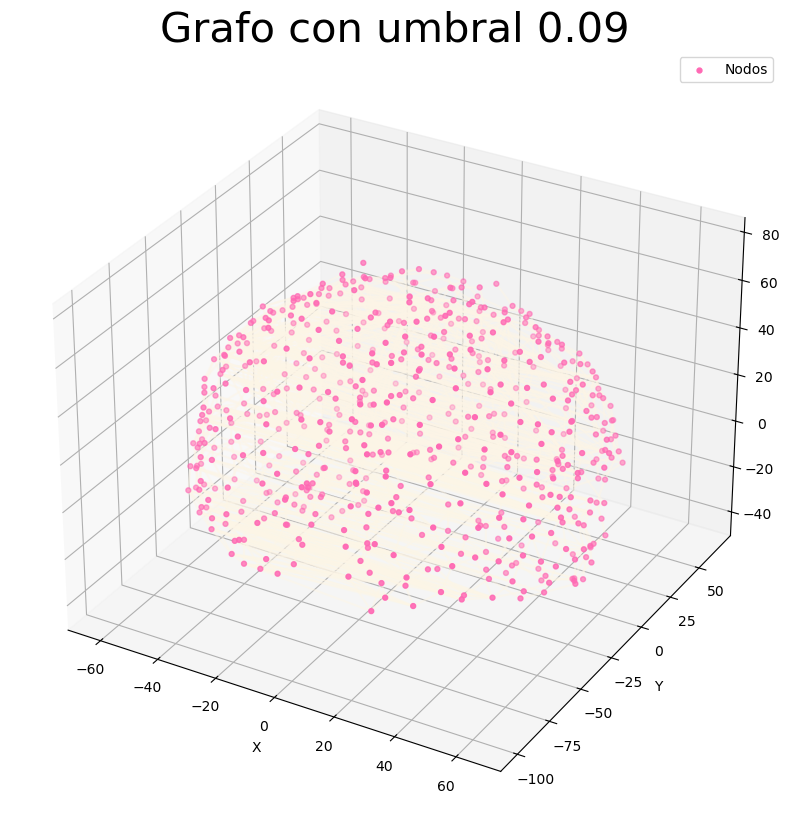

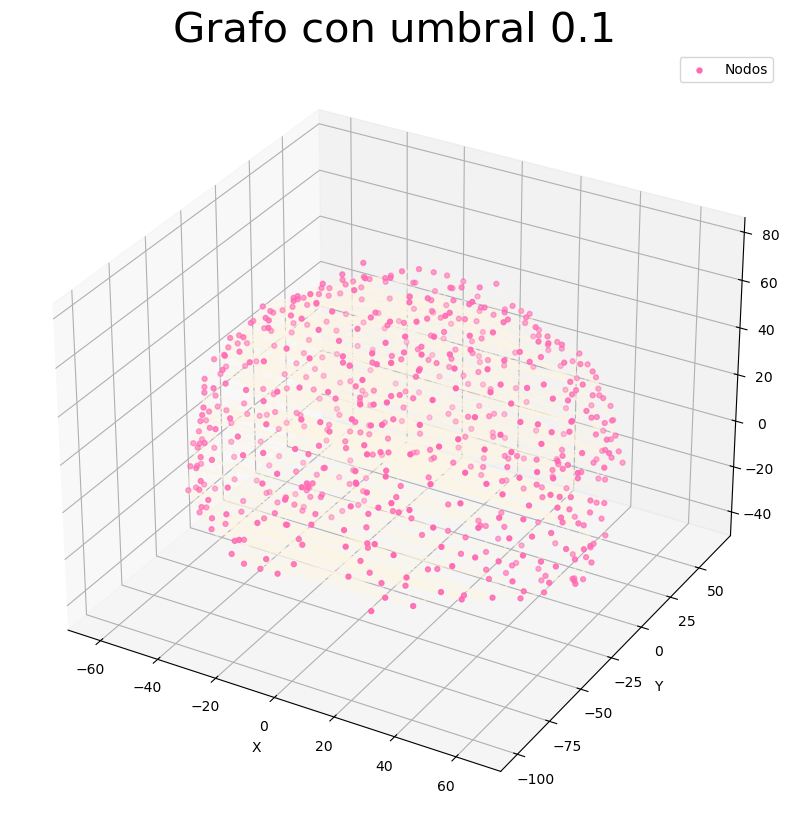

In [49]:
umbrales = [0.08, 0.09, 0.1]
for umbrales in umbrales:
    adj_mat = (cm >= umbrales).astype(int)
    G = nx.from_numpy_array(adj_mat)
    fig = plt.figure(figsize=(10, 10))
    ax = fig.add_subplot(projection='3d')
    ax.scatter(x, y, z, c='hotpink', s=50, marker='.', label="Nodos")
    
    print(f'\nConexiones para el grafo con umbral {umbrales}:')
    for edge in G.edges():
        node1, node2 = edge
        x_coords = [x[node1], x[node2]]
        y_coords = [y[node1], y[node2]]
        z_coords = [z[node1], z[node2]]
        ax.plot(x_coords, y_coords, z_coords, c='oldlace', alpha=0.5)
        print(f'Conexión: x={x_coords}, y={y_coords}, z={z_coords}')
    ax.set_title(f"Grafo con umbral {umbrales}", fontsize=30)
    ax.set_xlabel("X")
    ax.set_ylabel("Y")
    ax.set_zlabel("Z")
    ax.legend()
plt.show()

2. Con uno de los grafos en el punto uno con umbral 0.9, generar una animación
donde se haga girar 360° el grafo del cerebro para visualizar las conexiones
establecidas.

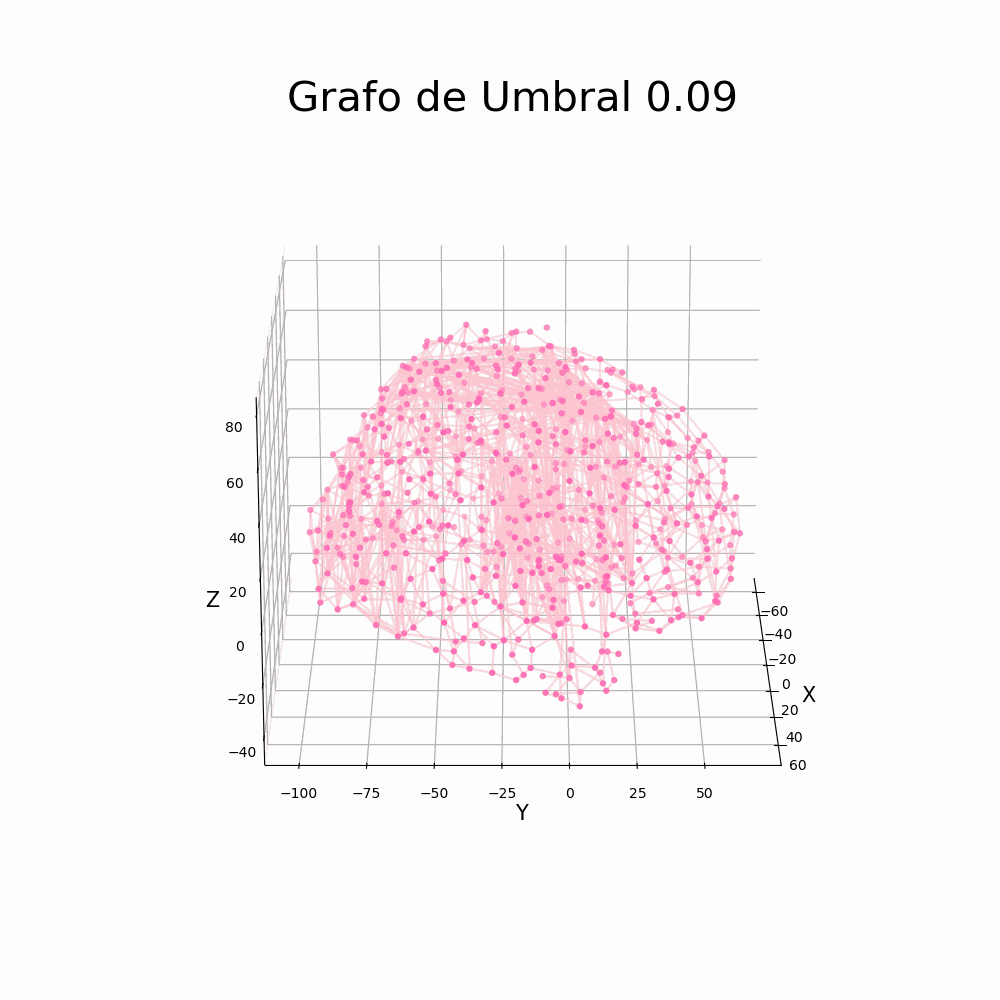

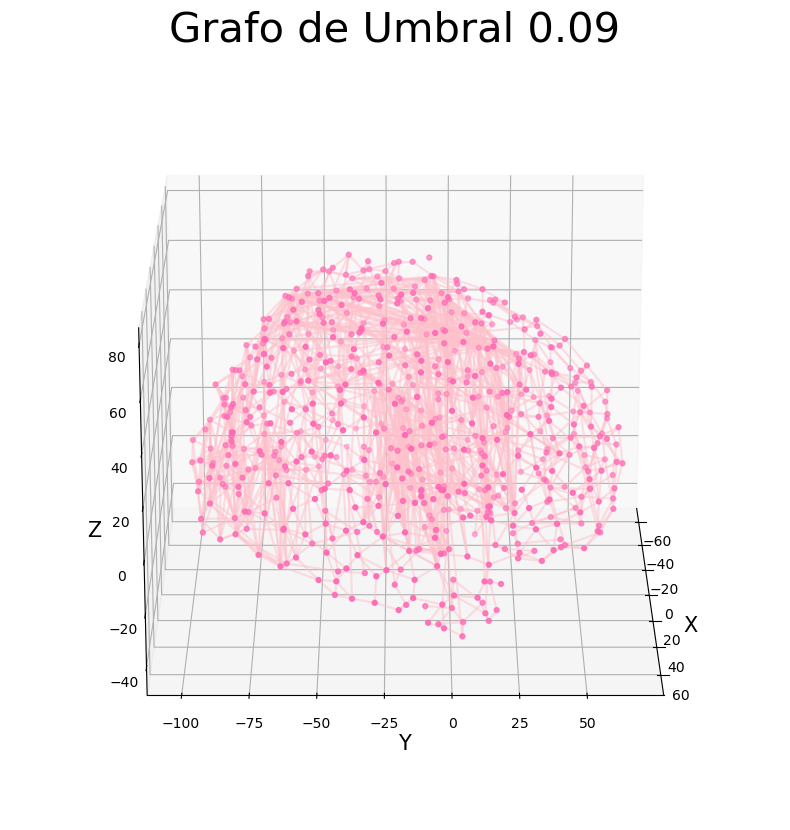

In [51]:
adj_mat = np.where(cm >= 0.09, cm, 0)
G= nx.from_numpy_array(adj_mat)
fig = plt.figure(figsize=(10, 10))
ax = fig.add_subplot(projection='3d')
ax.scatter(x, y, z, c='hotpink', s=50, marker='.', label ='Nodos')

for edge in G.edges():
    node1, node2 = edge
    x_coords = [x[node1], x[node2]]
    y_coords = [y[node1], y[node2]]
    z_coords = [z[node1], z[node2]]
    ax.plot(x_coords, y_coords, z_coords, c='pink', alpha=0.5)

ax.set_title(f'Grafo de Umbral 0.09', fontsize= 30)
ax.set_xlabel('X', fontsize= 15)
ax.set_ylabel('Y', fontsize= 15)
ax.set_zlabel('Z', fontsize= 15)

def init():
    ax.view_init(elev=20, azim=0)
    return fig,

def animate(frame):
    ax.view_init(elev=20, azim=frame)
    return fig,

animacion = FuncAnimation(fig, animate, init_func=init, frames=360, interval=50, blit=False)

karlenko = "animacion_09.gif"
animacion.save(karlenko, writer=PillowWriter(fps=20))
Image(r"C:\Users\holai\OneDrive\Escritorio\Semestre 5\Modelos Computacionales I\modelos-computacionales-I\Proyecto Final\animacion_09.gif")

3. Encontrar los hubs del grafo, y establecer el tamaño del nodo proporcional al valor
del grado.

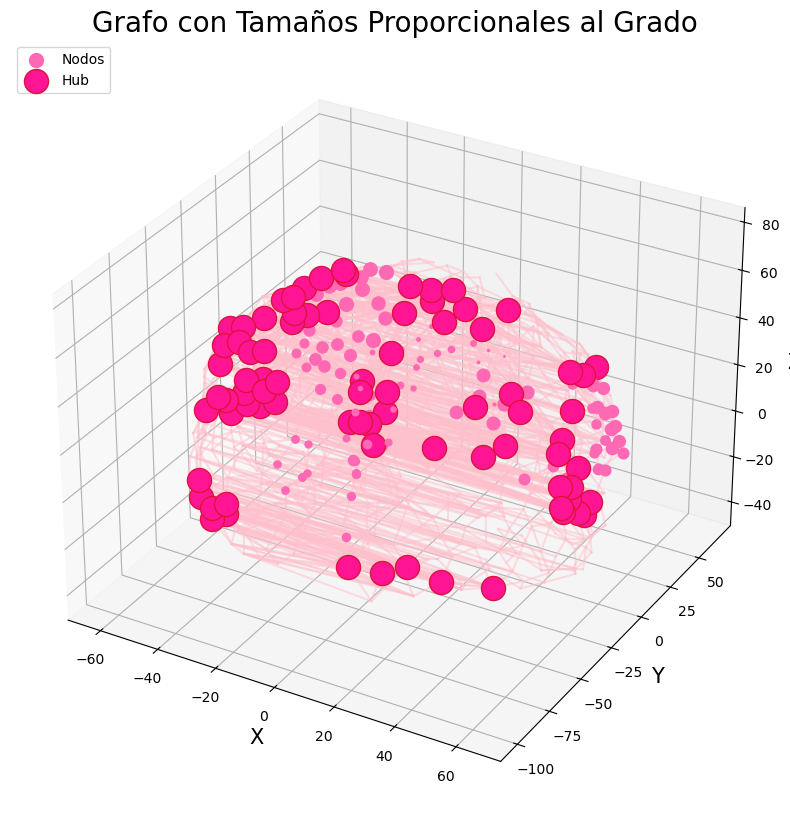

Existen 80 hubs en el grafo:
Estos hubs son: [19, 38, 69, 70, 100, 121, 135, 186, 202, 213, 230, 235, 237, 253, 261, 262, 266, 267, 271, 279, 285, 308, 309, 327, 328, 330, 331, 334, 344, 345, 346, 350, 352, 353, 356, 361, 362, 373, 393, 397, 400, 403, 407, 410, 416, 418, 452, 453, 454, 457, 465, 473, 477, 481, 482, 485, 488, 491, 494, 496, 500, 532, 552, 553, 599, 601, 603, 606, 607, 611, 612, 613, 615, 616, 617, 618, 619, 621, 622, 629]
El umbral para ser considerado hub es un grado de al menos 10.00.


In [53]:
degrees = dict(G.degree())
degree_values = list(degrees.values())
max_degree = max(degree_values)
min_degree = min(degree_values)
node_sizes = {i: i * 10 for i in range(101)} # xq 101, pudiste usar len
node_sizes_values = list(node_sizes.values())

fig = plt.figure(figsize=(10, 10))
ax = fig.add_subplot(111, projection="3d")

for node, size in zip(G.nodes(), node_sizes):
    ax.scatter(
        x[node], y[node], z[node],
        c="hotpink", s=size, label="Nodos" if size == max(node_sizes) else ""
    )

for edge in G.edges():
    node1, node2 = edge
    x_coords = [x[node1], x[node2]]
    y_coords = [y[node1], y[node2]]
    z_coords = [z[node1], z[node2]]
    ax.plot(x_coords, y_coords, z_coords, c="pink", alpha=0.5)

# xq esta forma de calcular hubs, hubs = grado arriba de media +una desviación estandar
hub_umbral = np.percentile(degree_values, 90)
hubs = [node for node, degree in degrees.items() if degree >= hub_umbral]

for hub in hubs:
    ax.scatter(
        x[hub], y[hub], z[hub],
        c="deeppink", s=300, edgecolors="crimson", label="Hub" if hub == hubs[0] else ""
    )

ax.set_title("Grafo con Tamaños Proporcionales al Grado", fontsize=20)
ax.set_xlabel("X", fontsize=15)
ax.set_ylabel("Y", fontsize=15)
ax.set_zlabel("Z", fontsize=15)
ax.legend(loc="upper left")

plt.show()

print(f"Existen {len(hubs)} hubs en el grafo:")
print(f"Estos hubs son: {hubs}")
print(f"El umbral para ser considerado hub es un grado de al menos {hub_umbral:.2f}.")

4. En función de la matriz de emparejamiento (correlación de la matriz de
adyacencia), establecer una partición de los nodos en módulos. Escoger el número
de módulos que creas conveniente y justificar por qué escogiste ese número.

In [55]:
# xq el threshold?
threshold = 0.2
adj_matrix = np.where(cm >= threshold, cm, 0)
corr_matrix = np.corrcoef(adj_matrix)

C:\Users\holai\anaconda3\Lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\holai\anaconda3\Lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


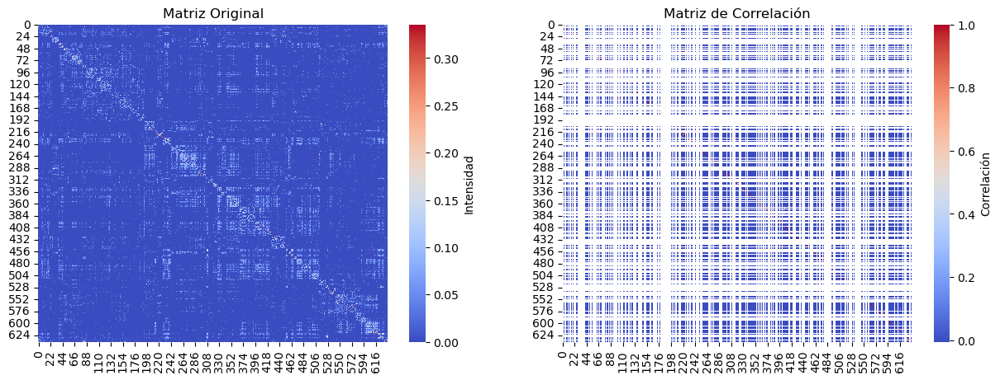

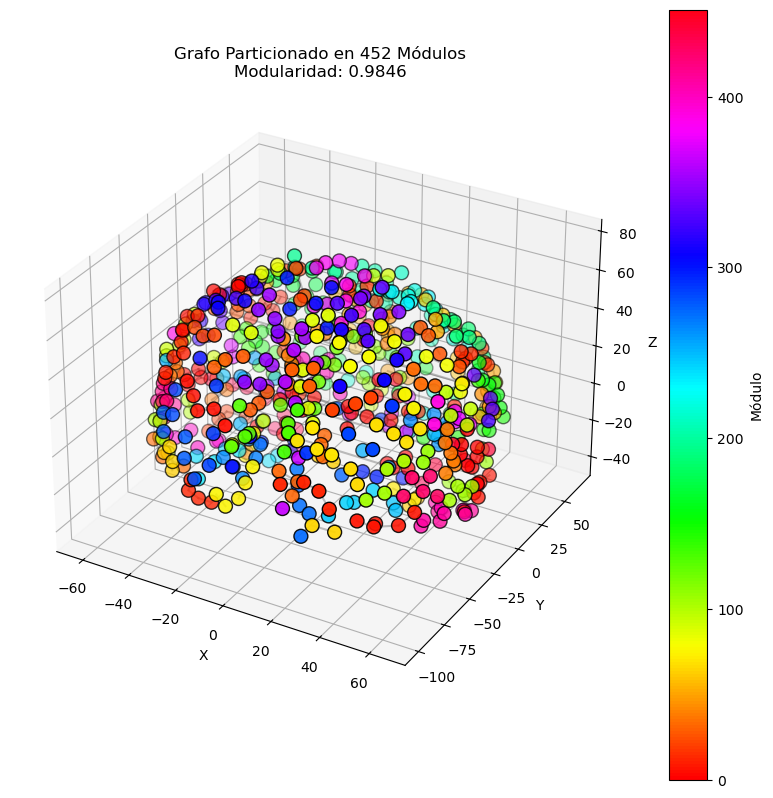

Se identificaron 452 módulos.
La modularidad obtenida es 0.9846. Al tener una división en comunidades eficaz, se pueden optimizar las conexiones internas dentro de los módulos.


In [56]:
plt.figure(figsize=(15, 5))
plt.subplot(1, 2, 1)
sns.heatmap(cm, cmap="coolwarm", cbar_kws={"label": "Intensidad"})
plt.title("Matriz Original")
plt.subplot(1, 2, 2)
sns.heatmap(corr_matrix, cmap="coolwarm", cbar_kws={"label": "Correlación"})
plt.title("Matriz de Correlación")
plt.show()

G = nx.from_numpy_array(adj_matrix)

# EXCELENTE INVESTIGACIÓN DE MÉTODOS
communities = list(greedy_modularity_communities(G))

partition = {}
for i, community in enumerate(communities):
    for node in community:
        partition[node] = i

modularity = nx.algorithms.community.quality.modularity(G, communities)
node_colors = [partition[node] for node in G.nodes()]

fig = plt.figure(figsize=(10, 10))
ax = fig.add_subplot(111, projection="3d")

scatter = ax.scatter(
    x, y, z, c=node_colors, cmap="hsv", s=100, edgecolors="black", label="Nodos"
)

for edge in G.edges():
    node1, node2 = edge
    x_edge = [x[node1], x[node2]]
    y_edge = [y[node1], y[node2]]
    z_edge = [z[node1], z[node2]]
    ax.plot(x_edge, y_edge, z_edge, c="gray", alpha=0.5)

ax.set_title(f"Grafo Particionado en {len(communities)} Módulos\nModularidad: {modularity:.4f}")
ax.set_xlabel("X")
ax.set_ylabel("Y")
ax.set_zlabel("Z")
plt.colorbar(scatter, ax=ax, label="Módulo")
plt.show()

print(f"Se identificaron {len(communities)} módulos.")
print(f"La modularidad obtenida es {modularity:.4f}. Al tener una división en comunidades eficaz, se pueden optimizar las conexiones internas dentro de los módulos.")

5. Determinar el conjunto del Rich Club y discutir las implicaciones anatómicas y
funcionales de este grupo de nodos (mínimo 100 palabras).

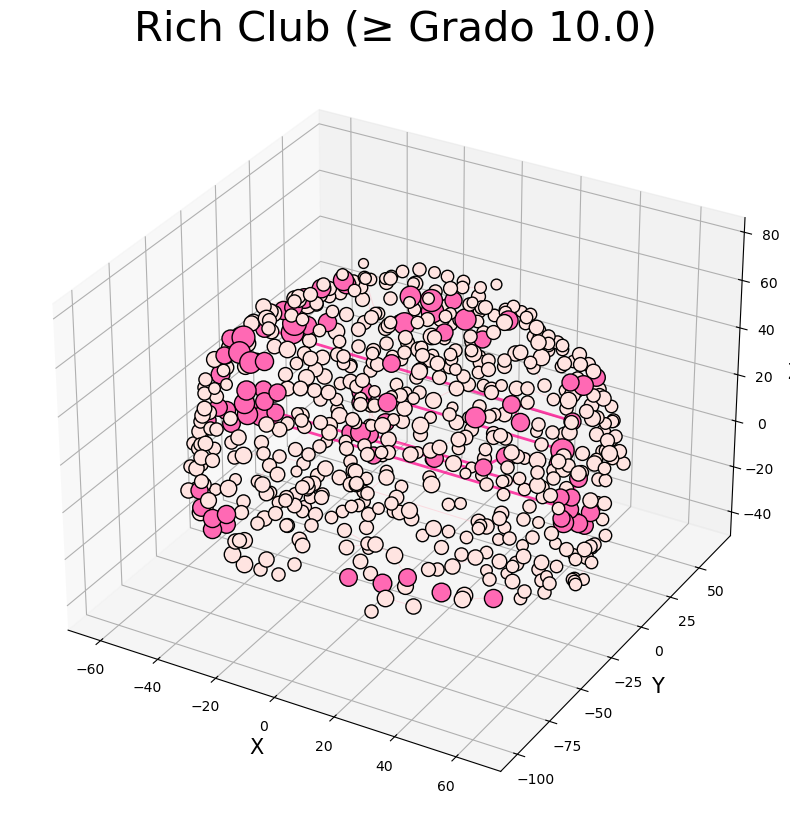

Rich Club con grado ≥ 10.0 (en rosa oscuro): [19, 38, 69, 70, 100, 121, 135, 186, 202, 213, 230, 235, 237, 253, 261, 262, 266, 267, 271, 279, 285, 308, 309, 327, 328, 330, 331, 334, 344, 345, 346, 350, 352, 353, 356, 361, 362, 373, 393, 397, 400, 403, 407, 410, 416, 418, 452, 453, 454, 457, 465, 473, 477, 481, 482, 485, 488, 491, 494, 496, 500, 532, 552, 553, 599, 601, 603, 606, 607, 611, 612, 613, 615, 616, 617, 618, 619, 621, 622, 629]


In [59]:
#
degree_umbral = np.percentile(list(degrees.values()), 90)
rich_club = [nodo for nodo, grado in degrees.items() if grado >= degree_umbral]

figura = plt.figure(figsize=(10, 10))
Ax = figura.add_subplot(projection="3d")

for nodo in degrees.keys():
    valor = degrees[nodo]
    tamaño = 50 + valor * 10 
    color = "hotpink" if nodo in rich_club else "mistyrose"
    Ax.scatter(x[nodo], y[nodo], z[nodo], color=color, s=tamaño, edgecolors="black")

for edge in G.edges():
    node1, node2 = edge
    x_coords = [x[node1], x[node2]]
    y_coords = [y[node1], y[node2]]
    z_coords = [z[node1], z[node2]]
    if node1 in rich_club and node2 in rich_club:
        Ax.plot(x_coords, y_coords, z_coords, c="deeppink", alpha=0.8, linewidth=2)
    else:
        Ax.plot(x_coords, y_coords, z_coords, c="pink", alpha=0.5, linewidth=0.7)


Ax.set_title(f"Rich Club (≥ Grado {degree_umbral})", fontsize=30)
Ax.set_xlabel("X", fontsize=15)
Ax.set_ylabel("Y", fontsize=15)
Ax.set_zlabel("Z", fontsize=15)
plt.show()

print(f"Rich Club con grado ≥ {degree_umbral} (en rosa oscuro): {rich_club}")

### Discusión 
El rich club se refiere a un conjunto de nodos pertenecientes a regiones cerebrales altamente interconectadas que actúan como centros de integración en el cerebro, estas regiones son críticas para coordinar redes cerebrales y optimizar la conectividad global, siendo fundamentales tanto en la organización normal como en alteraciones neurológicas.
Anatómicamente, incluyen áreas como la corteza prefrontal, parietal y el precúneo, conectadas por tractos de sustancia blanca densos y con altos costos metabólicos. 
Funcionalmente, facilitan la transferencia eficiente de información, apoyan funciones cognitivas complejas (memoria, planificación) y confieren resiliencia a la red ante daños. 
Cuando estos no existen o no funcionan correctamente, se puede vincular a trastornos como esquizofrenia.

6. Supongamos que eliminamos los nodos del RichClub, describir cómo cambian las
propiedades topológicas del grafo, hacer comparativas del grado, coeficiente de
cluster, coeficiente de mundo pequeño y las medidas de centralidad (cercanía,
intermediación)

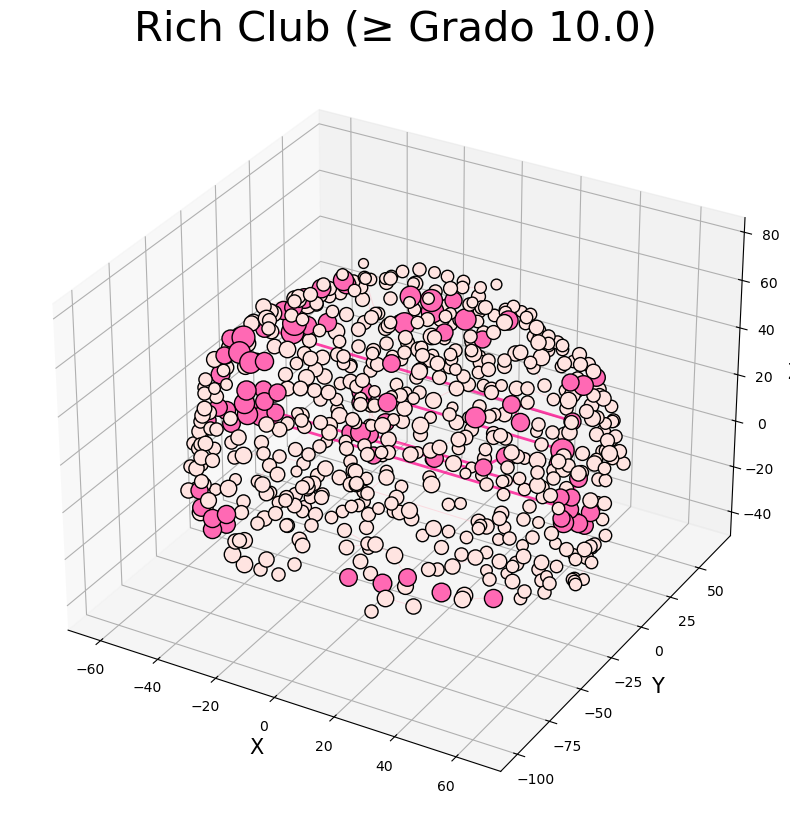

Rich Club con grado ≥ 10.0 (en rosa oscuro): [19, 38, 69, 70, 100, 121, 135, 186, 202, 213, 230, 235, 237, 253, 261, 262, 266, 267, 271, 279, 285, 308, 309, 327, 328, 330, 331, 334, 344, 345, 346, 350, 352, 353, 356, 361, 362, 373, 393, 397, 400, 403, 407, 410, 416, 418, 452, 453, 454, 457, 465, 473, 477, 481, 482, 485, 488, 491, 494, 496, 500, 532, 552, 553, 599, 601, 603, 606, 607, 611, 612, 613, 615, 616, 617, 618, 619, 621, 622, 629]


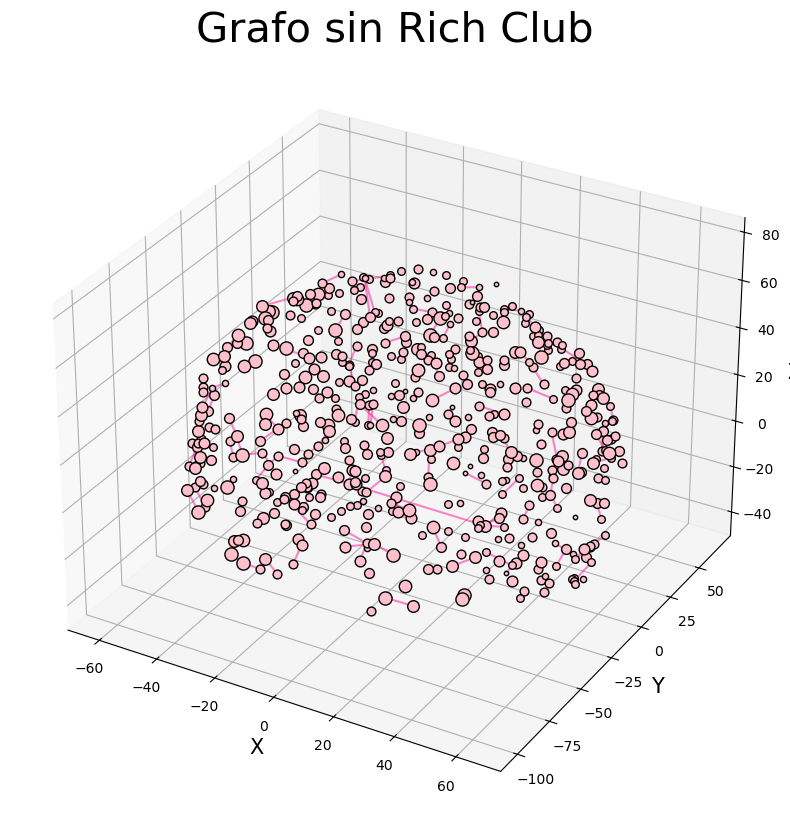

In [86]:
# CON RICH CLUB

figura = plt.figure(figsize=(10, 10))
Ax = figura.add_subplot(projection="3d")

for nodo in degrees.keys():
    valor = degrees[nodo]
    tamaño = 50 + valor * 10 
    color = "hotpink" if nodo in rich_club else "mistyrose"
    Ax.scatter(x[nodo], y[nodo], z[nodo], color=color, s=tamaño, edgecolors="black")

for edge in G.edges():
    node1, node2 = edge
    x_coords = [x[node1], x[node2]]
    y_coords = [y[node1], y[node2]]
    z_coords = [z[node1], z[node2]]
    if node1 in rich_club and node2 in rich_club:
        Ax.plot(x_coords, y_coords, z_coords, c="deeppink", alpha=0.8, linewidth=2)
    else:
        Ax.plot(x_coords, y_coords, z_coords, c="pink", alpha=0.5, linewidth=0.7)


Ax.set_title(f"Rich Club (≥ Grado {degree_umbral})", fontsize=30)
Ax.set_xlabel("X", fontsize=15)
Ax.set_ylabel("Y", fontsize=15)
Ax.set_zlabel("Z", fontsize=15)
plt.show()

print(f"Rich Club con grado ≥ {degree_umbral} (en rosa oscuro): {rich_club}")

# SIN RICH CLUB

sin_rich_club = G.copy()
sin_rich_club.remove_nodes_from(rich_club)

figura = plt.figure(figsize=(10, 10))
Ax = figura.add_subplot(projection='3d')

for nodo in G_sin_rich_club.nodes():
    valor = degrees.get(nodo, 0)
    tamaño = node_sizes.get(valor, 10)
    Ax.scatter(x[nodo], y[nodo], z[nodo], color='pink', s=tamaño, edgecolors="black")

for edge in G_sin_rich_club.edges():
    node1, node2 = edge
    x_coords = [x[node1], x[node2]]
    y_coords = [y[node1], y[node2]]
    z_coords = [z[node1], z[node2]]
    Ax.plot(x_coords, y_coords, z_coords, c='deeppink', alpha=0.5)

Ax.set_title('Grafo sin Rich Club', fontsize=30)
Ax.set_xlabel('X', fontsize=15)
Ax.set_ylabel('Y', fontsize=15)
Ax.set_zlabel('Z', fontsize=15)
plt.show()

In [88]:
G_sin_rich_club = G.copy()
G_sin_rich_club.remove_nodes_from(rich_club)

def calcular_propiedades(G, nombre):
    propiedades = {}
    propiedades["Número de nodos"] = G.number_of_nodes()
    propiedades["Número de aristas"] = G.number_of_edges()
    propiedades["Grado promedio"] = sum(dict(G.degree()).values()) / G.number_of_nodes()
    propiedades["Coeficiente de clustering promedio"] = nx.average_clustering(G)
    
    propiedades["Centralidad de cercanía (promedio)"] = np.mean(list(nx.closeness_centrality(G).values()))
    propiedades["Centralidad de intermediación (promedio)"] = np.mean(list(nx.betweenness_centrality(G).values()))
    print(f"Propiedades del grafo {nombre}:")
    for key, value in propiedades.items():
        print(f"  {key}: {value}")
    print()
    return propiedades

propiedades_original = calcular_propiedades(G, 'Original (con Rich Club)')
propiedades_sin_rich_club = calcular_propiedades(G_sin_rich_club, 'Sin Rich Club (modificado)')

Propiedades del grafo Original (con Rich Club):
  Número de nodos: 638
  Número de aristas: 188
  Grado promedio: 0.5893416927899686
  Coeficiente de clustering promedio: 0.004702194357366771
  Centralidad de cercanía (promedio): 0.0011233322643708667
  Centralidad de intermediación (promedio): 2.3135769952388597e-06

Propiedades del grafo Sin Rich Club (modificado):
  Número de nodos: 558
  Número de aristas: 124
  Grado promedio: 0.4444444444444444
  Coeficiente de clustering promedio: 0.005376344086021506
  Centralidad de cercanía (promedio): 0.0008984359112735014
  Centralidad de intermediación (promedio): 9.143088031457038e-07



7. Quitar 10%-50% de los nodos con mayor medida de intermediación y describir
cómo cambian las propiedades topológicas del grafo, hacer comparativas del grado,
coeficiente de cluster, coeficiente de mundo pequeño y las medidas de centralidad
(cercanía, intermediación)

Propiedades del grafo original:
{'grado_medio': 0.5893416927899686, 'coef_clustering': 0.004702194357366771, 'centralidad_cercania_media': 0.0011233322643708667, 'centralidad_intermediacion_media': 2.3135769952388597e-06, 'coef_mundo_pequeño': 0.03260869565217391}

Propiedades tras eliminar 10% de los nodos:
{'grado_medio': 0.271304347826087, 'coef_clustering': 0.0052173913043478265, 'centralidad_cercania_media': 0.0004746755542089582, 'centralidad_intermediacion_media': 1.0575371598729157e-08, 'coef_mundo_pequeño': 0.75}


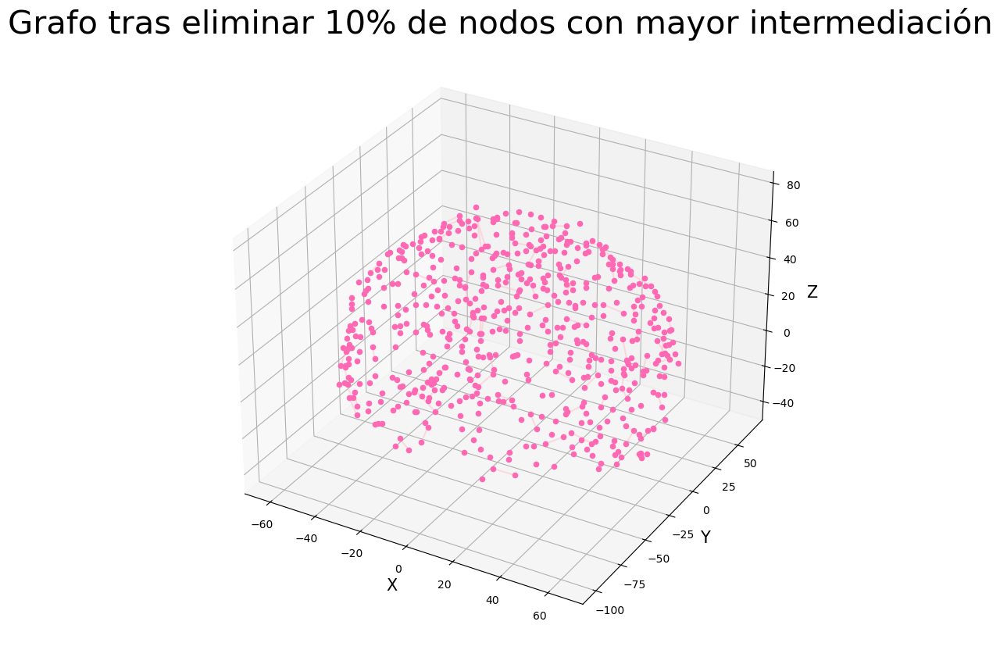


Propiedades tras eliminar 20% de los nodos:
{'grado_medio': 0.2622309197651663, 'coef_clustering': 0.005870841487279843, 'centralidad_cercania_media': 0.0005141782740493458, 'centralidad_intermediacion_media': 0.0, 'coef_mundo_pequeño': 1.0}


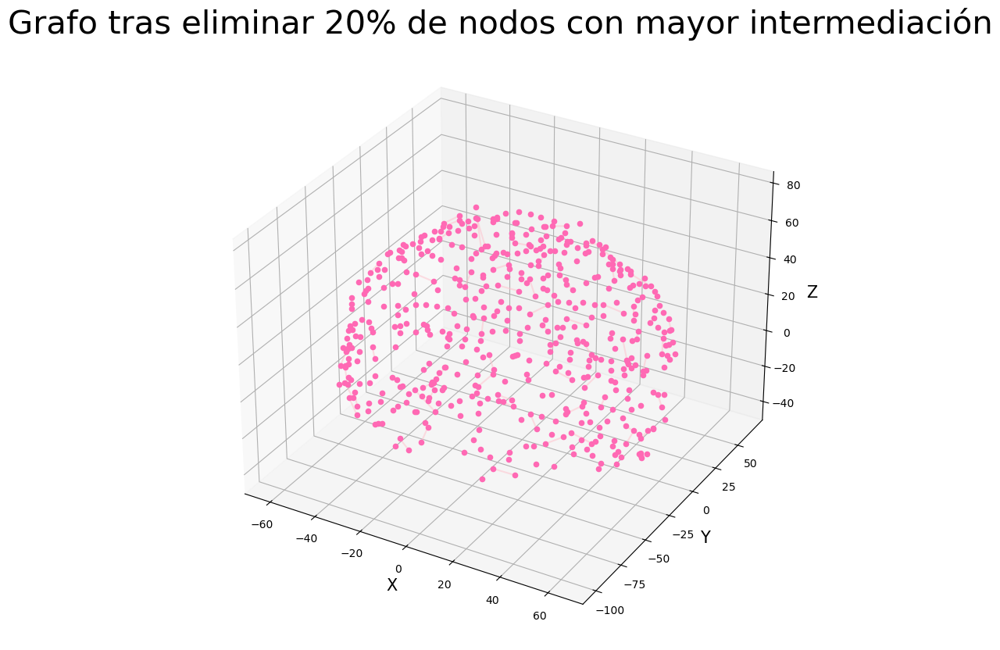


Propiedades tras eliminar 30% de los nodos:
{'grado_medio': 0.2550335570469799, 'coef_clustering': 0.006711409395973154, 'centralidad_cercania_media': 0.0005718241189394168, 'centralidad_intermediacion_media': 0.0, 'coef_mundo_pequeño': 1.0}


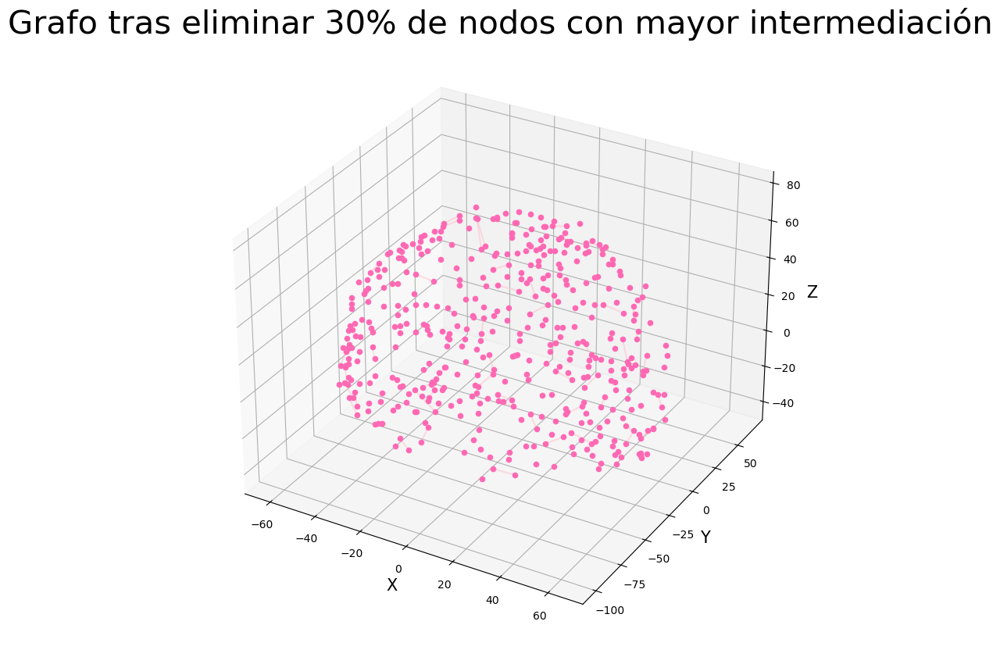


Propiedades tras eliminar 40% de los nodos:
{'grado_medio': 0.26631853785900783, 'coef_clustering': 0.007832898172323759, 'centralidad_cercania_media': 0.0006971689472748897, 'centralidad_intermediacion_media': 0.0, 'coef_mundo_pequeño': 1.0}


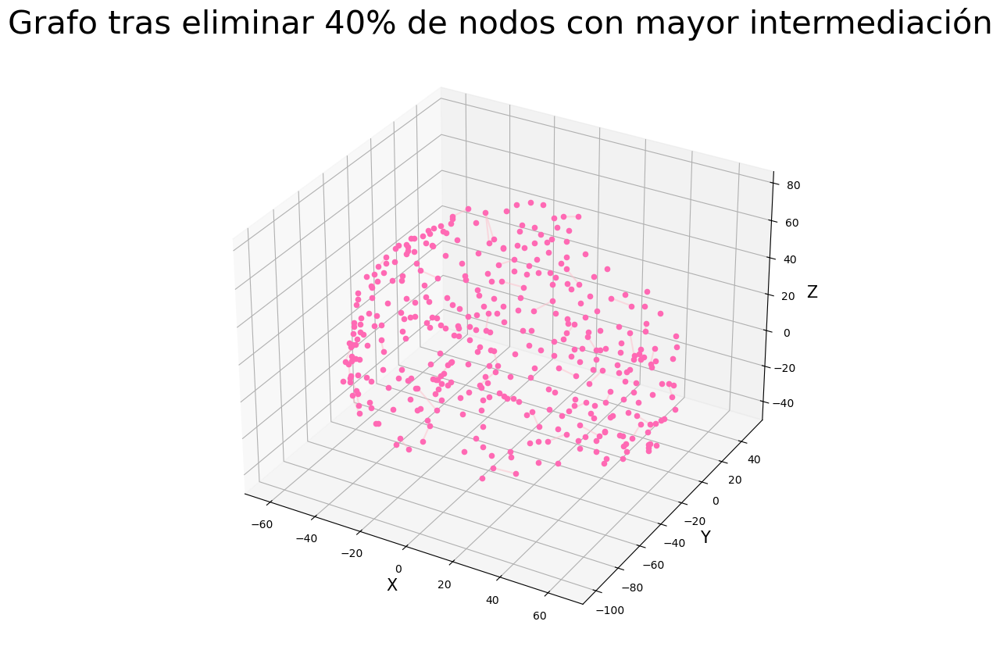


Propiedades tras eliminar 50% de los nodos:
{'grado_medio': 0.26959247648902823, 'coef_clustering': 0.009404388714733543, 'centralidad_cercania_media': 0.000847775083298831, 'centralidad_intermediacion_media': 0.0, 'coef_mundo_pequeño': 1.0}


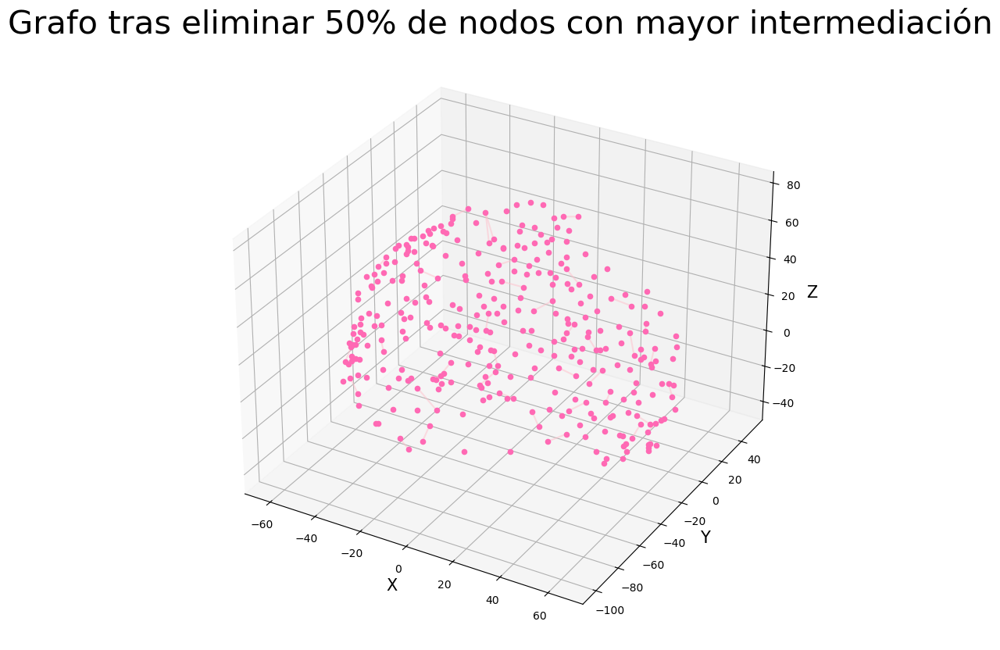

In [93]:
# PUDISTE REUTILIZAR LA FUNCIÓN calcular_propiedades
def calcular_propiedades_grafo(G):
    propiedades = {}
    propiedades['grado_medio'] = sum(dict(G.degree()).values()) / G.number_of_nodes()
    propiedades['coef_clustering'] = nx.average_clustering(G)
    propiedades['centralidad_cercania_media'] = np.mean(list(nx.closeness_centrality(G).values()))
    propiedades['centralidad_intermediacion_media'] = np.mean(list(nx.betweenness_centrality(G).values()))
    propiedades['coef_mundo_pequeño'] = nx.transitivity(G)
    return propiedades

def eliminar_porcentaje_nodos(G, porcentaje):
    intermediacion = nx.betweenness_centrality(G)
    nodos_ord = sorted(intermediacion, key=intermediacion.get, reverse=True)
    num_del_nodos = int(len(nodos_ord) * porcentaje / 100)
    del_nodos = nodos_ord[:num_del_nodos]

    G_modificado = G.copy()
    G_modificado.remove_nodes_from(del_nodos)
    return G_modificado, del_nodos

def graficar_grafo_3d(G, x, y, z, nodos_eliminados=None, titulo="Grafo"):
    fig = plt.figure(figsize=(10, 10))
    ax = fig.add_subplot(111, projection='3d')

    for nodo in G.nodes():
        color = "deeppink" if nodos_eliminados and nodo in nodos_eliminados else "hotpink"
        ax.scatter(x[nodo], y[nodo], z[nodo], color=color, s=20)

    for edge in G.edges():
        node1, node2 = edge
        x_coords = [x[node1], x[node2]]
        y_coords = [y[node1], y[node2]]
        z_coords = [z[node1], z[node2]]
        ax.plot(x_coords, y_coords, z_coords, c="pink", alpha=0.5)

    ax.set_title(titulo, fontsize=30)
    ax.set_xlabel("X", fontsize=15)
    ax.set_ylabel("Y", fontsize=15)
    ax.set_zlabel("Z", fontsize=15)
    plt.show()

porcentajes = [10, 20, 30, 40, 50]

propiedades_originales = calcular_propiedades_grafo(G)
print("Propiedades del grafo original:")
print(propiedades_originales)

for porcentaje in porcentajes:
    G_modificado, nodos_eliminados = eliminar_porcentaje_nodos(G, porcentaje)
    propiedades_modificadas = calcular_propiedades_grafo(G_modificado)
    print(f"\nPropiedades tras eliminar {porcentaje}% de los nodos:")
    print(propiedades_modificadas)

    graficar_grafo_3d(
        G_modificado, 
        x, y, z, 
        nodos_eliminados=nodos_eliminados, 
        titulo=f"Grafo tras eliminar {porcentaje}% de nodos con mayor intermediación"
    )


8. Generar un modelo nulo aleatorio donde se tenga el mismo número de nodos y el
mismo número total de conexiones, y comparar sus propiedades con el grafo original
del cerebro.

Propiedades del Grafo Original:
{'grado_medio': 4.529780564263323, 'coef_clustering': 0.24364464673564803, 'centralidad_cercania_media': 0.1194031264903796, 'centralidad_intermediacion_media': 0.01147712930871217}

Propiedades del Grafo Nulo Aleatorio:
{'grado_medio': 4.529780564263323, 'coef_clustering': 0.005189829327760362, 'centralidad_cercania_media': 0.22429614341094697, 'centralidad_intermediacion_media': 0.005421778704611682}


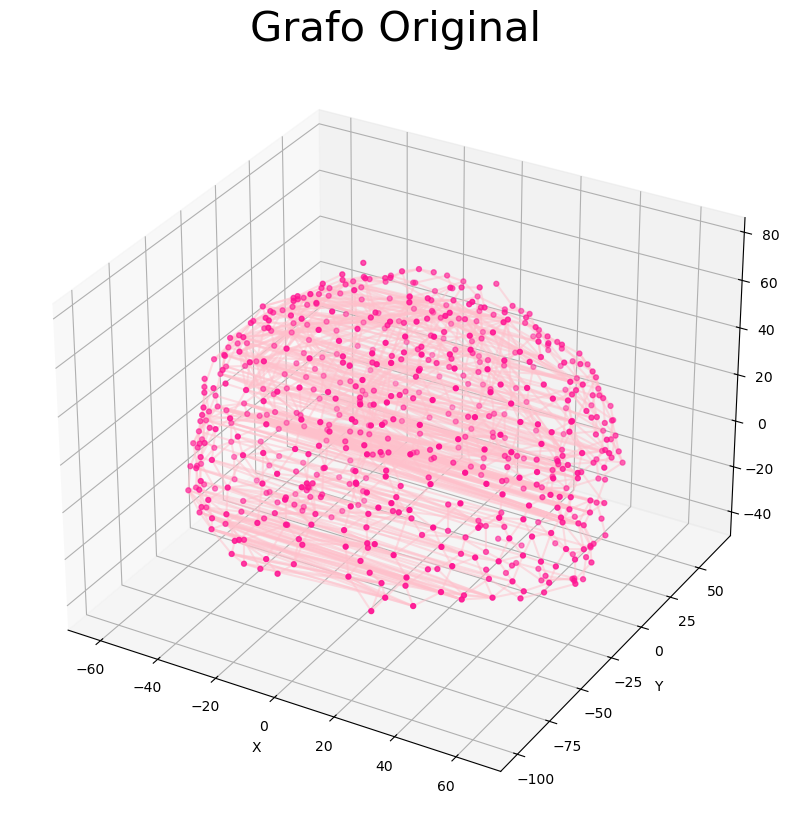

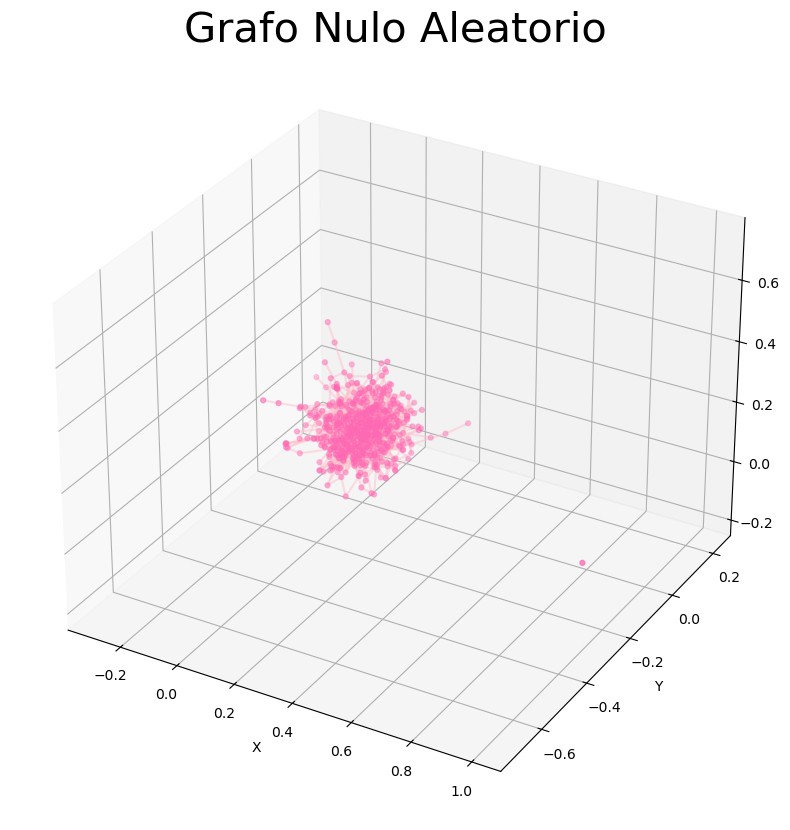

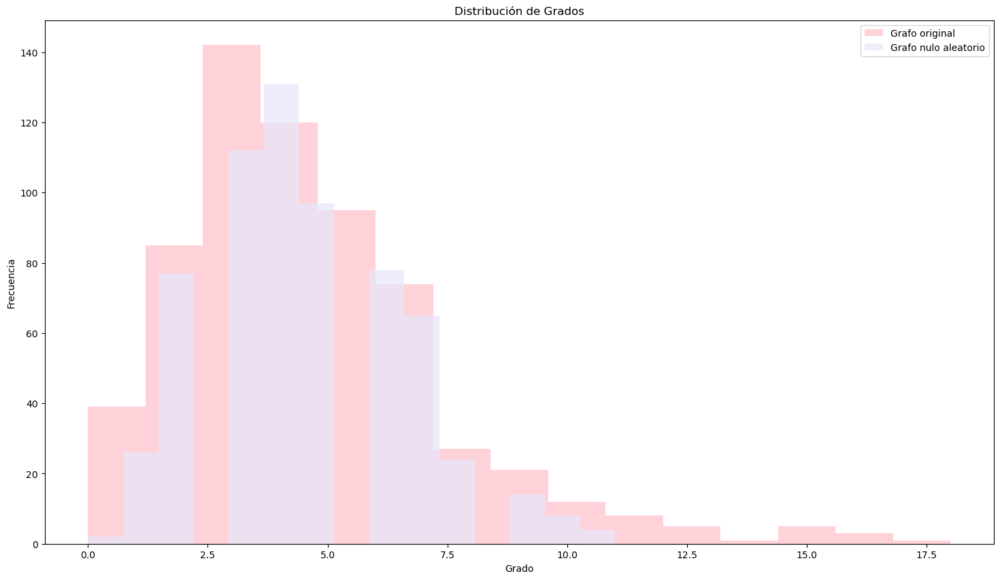

In [106]:
def calcular_propiedades_grafo(G):
    propiedades = {
        "grado_medio": sum(dict(G.degree()).values()) / G.number_of_nodes(),
        "coef_clustering": nx.average_clustering(G),
        "centralidad_cercania_media": np.mean(list(nx.closeness_centrality(G).values())),
        "centralidad_intermediacion_media": np.mean(list(nx.betweenness_centrality(G).values())),
    }
    return propiedades

def generar_grafo_nulo(num_nodos, num_aristas):
    return nx.gnm_random_graph(num_nodos, num_aristas)

def graficar_grafo_3d(G, x=None, y=None, z=None, titulo="Grafo 3D"):
    fig = plt.figure(figsize=(10, 10))
    ax = fig.add_subplot(111, projection='3d')

    if x is not None and y is not None and z is not None:
        ax.scatter(x, y, z, c='deeppink', s=50, marker='.')
        for edge in G.edges():
            node1, node2 = edge
            x_coords = [x[node1], x[node2]]
            y_coords = [y[node1], y[node2]]
            z_coords = [z[node1], z[node2]]
            ax.plot(x_coords, y_coords, z_coords, c='pink', alpha=0.5)
    else:
        pos = nx.spring_layout(G, dim=3)
        x, y, z = np.array(list(pos.values())).T
        ax.scatter(x, y, z, c='hotpink', s=50, marker='.')
        for edge in G.edges():
            node1, node2 = edge
            x_coords = [x[node1], x[node2]]
            y_coords = [y[node1], y[node2]]
            z_coords = [z[node1], z[node2]]
            ax.plot(x_coords, y_coords, z_coords, c='pink', alpha=0.5)

    ax.set_title(titulo, fontsize=30)
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('Z')
    plt.show()

# XQ ESTE HUMBRAL?
umbral1 = 0.1
matriz_filtrada = np.where(cm >= umbral1, cm, 0)

G = nx.from_numpy_array(matriz_filtrada)
num_nodos = G.number_of_nodes()
num_aristas = G.number_of_edges()
G_random = generar_grafo_nulo(num_nodos, num_aristas)

propiedades_original = calcular_propiedades_grafo(G)
propiedades_random = calcular_propiedades_grafo(G_random)

print("Propiedades del Grafo Original:")
print(propiedades_original)
print("\nPropiedades del Grafo Nulo Aleatorio:")
print(propiedades_random)

graficar_grafo_3d(G, x, y, z, titulo="Grafo Original")
graficar_grafo_3d(G_random, titulo="Grafo Nulo Aleatorio")

grados_original = [grado for nodo, grado in G.degree()]
grados_random = [grado for nodo, grado in G_random.degree()]

plt.figure(figsize=(18, 10))
plt.hist(grados_original, bins=15, alpha=0.7, label="Grafo original", color="pink")
plt.hist(grados_random, bins=15, alpha=0.7, label="Grafo nulo aleatorio", color="lavender")
plt.title("Distribución de Grados")
plt.xlabel("Grado")
plt.ylabel("Frecuencia")
plt.legend()
plt.show()

9. Generar un modelo nulo aleatorio donde se conserve la distribución de grado y
comparar sus propiedades con el grafo original del cerebro.


Propiedades del grafo original:
{'grado_medio': 4.529780564263323, 'coeficiente_de_agrupamiento': 0.24364464673564803, 'centralidad_cercania': 0.1194031264903796, 'centralidad_intermediacion': 0.01147712930871217}

Propiedades del grafo nulo:
{'grado_medio': 4.5266457680250785, 'coeficiente_de_agrupamiento': 0.0068135203968690975, 'centralidad_cercania': 0.23074926476872124, 'centralidad_intermediacion': 0.005086967746136814}


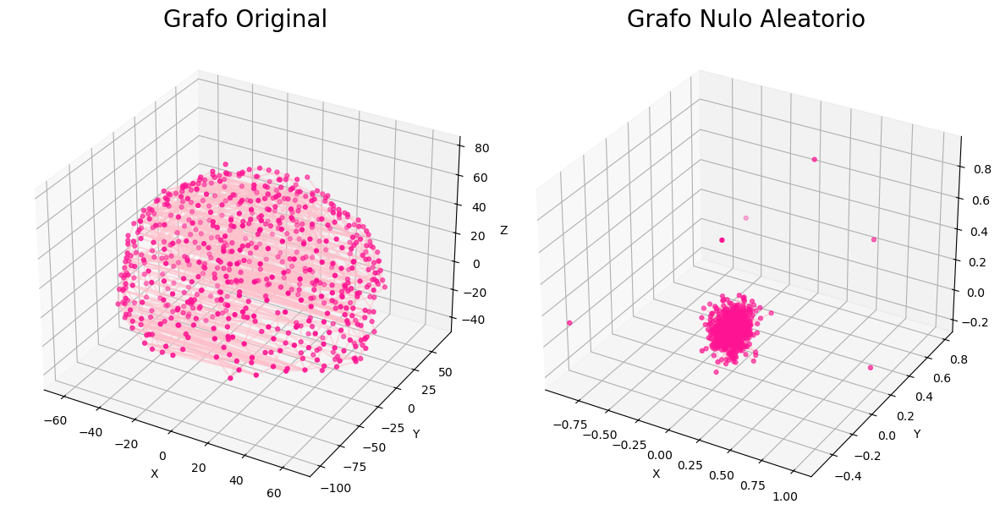

In [128]:
def propiedades_grafo(G):
    propiedades = {}
    avg_grad = sum(dict(G.degree()).values()) / G.number_of_nodes()
    propiedades['grado_medio'] = avg_grad
    coef_cluster = nx.average_clustering(G)
    propiedades['coeficiente_de_agrupamiento'] = coef_cluster
    cercania = np.mean(list(nx.closeness_centrality(G).values()))
    propiedades['centralidad_cercania'] = cercania
    betweenness = nx.betweenness_centrality(G)
    intermediacion = np.mean(list(betweenness.values()))
    propiedades['centralidad_intermediacion'] = intermediacion
    return propiedades

def grafo_nulo_con_grados(G):
    G_random = nx.configuration_model([d for n, d in G.degree()])
    G_random = nx.Graph(G_random)
    G_random.remove_edges_from(nx.selfloop_edges(G_random))
    return G_random

def graficar_grafo_3d(G, x, y, z, ax, titulo):
    ax.scatter(x, y, z, c='pink', s=50, marker='.')
    for edge in G.edges():
        node1, node2 = edge
        x_coords = [x[node1], x[node2]]
        y_coords = [y[node1], y[node2]]
        z_coords = [z[node1], z[node2]]
        ax.plot(x_coords, y_coords, z_coords, c='mistyrose', alpha=0.5)
    ax.set_title(titulo, fontsize=30)
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('Z')

matriz_filtrada = np.where(cm >= umbral1, cm, 0)
G_original = nx.from_numpy_array(matriz_filtrada)

num_nodos = G.number_of_nodes()
num_aristas = G.number_of_edges()

G_random = grafo_nulo_con_grados(G_original)

propiedades_original = propiedades_grafo(G_original)
propiedades_random = propiedades_grafo(G_random)

print(f"\nPropiedades del grafo original:\n{propiedades_original}")
print(f"\nPropiedades del grafo nulo:\n{propiedades_random}")

fig = plt.figure(figsize=(12, 6))
ax1 = fig.add_subplot(121, projection='3d')
ax1.scatter(x, y, z, c='deeppink', s=50, marker='.')
for edge in G.edges():
    node1, node2 = edge
    x_coords = [x[node1], x[node2]]
    y_coords = [y[node1], y[node2]]
    z_coords = [z[node1], z[node2]]
    ax1.plot(x_coords, y_coords, z_coords, c='pink', alpha=0.5)
ax1.set_title(f'Grafo Original', fontsize=20)
ax1.set_xlabel('X')
ax1.set_ylabel('Y')
ax1.set_zlabel('Z')

ax2 = fig.add_subplot(122, projection='3d')
pos_random = nx.spring_layout(G_random, dim=3) 
x_r, y_r, z_r = np.array(list(pos_random.values())).T
ax2.scatter(x_r, y_r, z_r, c='deeppink', s=50, marker='.')
for edge in G_random.edges():
    node1, node2 = edge
    x_coords = [x_r[node1], x_r[node2]]
    y_coords = [y_r[node1], y_r[node2]]
    z_coords = [z_r[node1], z_r[node2]]
    ax2.plot(x_coords, y_coords, z_coords, c='pink', alpha=0.5)
ax2.set_title(f'Grafo Nulo Aleatorio', fontsize=20)
ax2.set_xlabel('X')
ax2.set_ylabel('Y')
ax2.set_zlabel('Z')
plt.tight_layout()
plt.show()

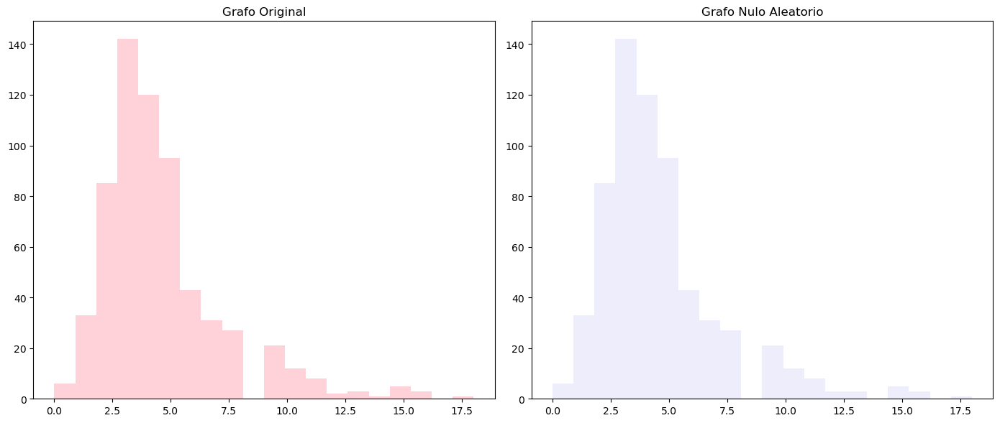

In [133]:
# Histogramas para comparar

fig, axes = plt.subplots(1, 2, figsize=(14, 6))

ax1 = axes[0]
grados_original = [d for n, d in G_original.degree()]
ax1.hist(grados_original, bins=20, color='pink', alpha=0.7)
ax1.set_title("Grafo Original")

# Grafo nulo aleatorio
ax2 = axes[1]
grados_random = [d for n, d in G_random.degree()]
ax2.hist(grados_random, bins=20, color='lavender', alpha=0.7)
ax2.set_title("Grafo Nulo Aleatorio")

plt.tight_layout()
plt.show()

10. Generar un modelo nulo utilizando una probabilidad de conexión en función de la
distancia geométrica, con el mismo número de nodos y conexiones y compara sus
propiedades y discutir la importancia de las conexiones a larga distancia en el
cerebro.


Propiedades del grafo original
{'grado_medio': 4.529780564263323, 'coeficiente_de_agrupamiento': 0.24364464673564803, 'centralidad_cercania': 0.1194031264903796, 'centralidad_intermediacion': 0.01147712930871217}

Propiedades del grafo nulo basado en distancia
{'grado_medio': 4.529780564263323, 'coeficiente_de_agrupamiento': 0.004061438387457196, 'centralidad_cercania': 0.2208052451871795, 'centralidad_intermediacion': 0.005177862692501599}


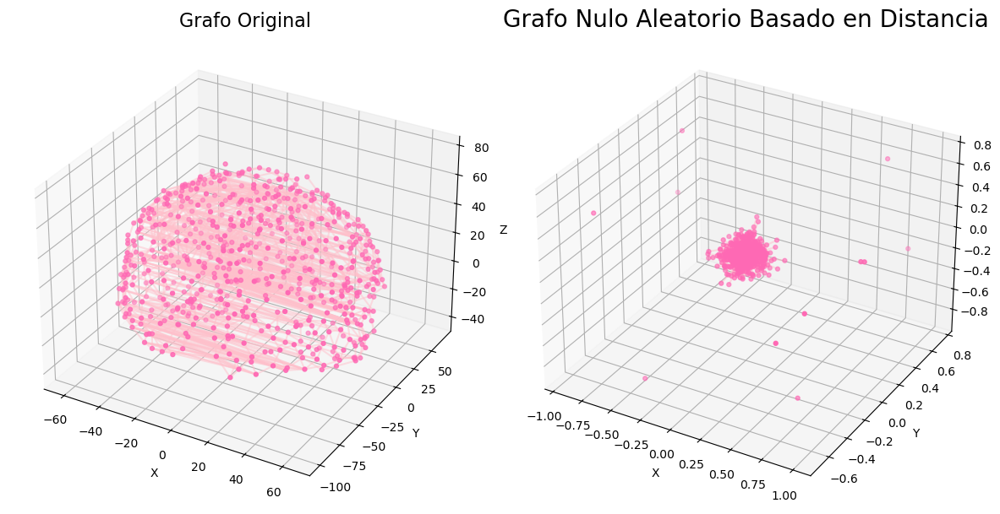

In [161]:
def distancia_euclidiana(i, j, coord):
    return np.linalg.norm(coord[i] - coord[j])

def grafo_nulo_distancia(coord, num_nodos, num_aristas, alpha=0.1):
    edges = [
        (i, j)
        for i in range(num_nodos)
        for j in range(i + 1, num_nodos)
        if np.random.rand() < 1 / (1 + alpha * distancia_euclidiana(i, j, coord))
    ]

    np.random.shuffle(edges)
    edges = edges[:num_aristas]

    G_random = nx.Graph()
    G_random.add_nodes_from(range(num_nodos))
    G_random.add_edges_from(edges)
    return G_random

def graficar_grafo_3d(G, coord, ax, titulo, color='pink'):
    x, y, z = coord[:, 0], coord[:, 1], coord[:, 2]
    ax.scatter(x, y, z, c='hotpink', s=50, marker='.')
    for edge in G.edges():
        node1, node2 = edge
        ax.plot([x[node1], x[node2]], [y[node1], y[node2]], [z[node1], z[node2]], c=color, alpha=0.5)
    ax.set_title(titulo, fontsize=16)
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('Z')

matriz_filtrada = np.where(cm >= umbral1, cm, 0)
G_original = nx.from_numpy_array(matriz_filtrada)
num_nodos = G_original.number_of_nodes()
num_aristas = G_original.number_of_edges()
G_nulo_distancia = grafo_nulo_distancia(coords, num_nodos, num_aristas)

print("\nPropiedades del grafo original")
print(propiedades_grafo(G_original))
print("\nPropiedades del grafo nulo basado en distancia")
print(propiedades_grafo(G_nulo_distancia))

fig = plt.figure(figsize=(12, 6))

ax1 = fig.add_subplot(121, projection='3d')
ax1.scatter(x, y, z, c='hotpink', s=50, marker='.')
for edge in G.edges():
    node1, node2 = edge
    x_coords = [x[node1], x[node2]]
    y_coords = [y[node1], y[node2]]
    z_coords = [z[node1], z[node2]]
    ax1.plot(x_coords, y_coords, z_coords, c='pink', alpha=0.5)
ax1.set_title(f'Grafo Original', fontsize=16)
ax1.set_xlabel('X')
ax1.set_ylabel('Y')
ax1.set_zlabel('Z')

ax2 = fig.add_subplot(122, projection='3d')
pos_random = nx.spring_layout(G_nulo_distancia, dim=3) 
x_r, y_r, z_r = np.array(list(pos_random.values())).T
ax2.scatter(x_r, y_r, z_r, c='hotpink', s=50, marker='.')
for edge in G_nulo_distancia.edges():
    node1, node2 = edge
    x_coords = [x_r[node1], x_r[node2]]
    y_coords = [y_r[node1], y_r[node2]]
    z_coords = [z_r[node1], z_r[node2]]
    ax2.plot(x_coords, y_coords, z_coords, c='pink', alpha=0.5)
ax2.set_title(f'Grafo Nulo Aleatorio Basado en Distancia', fontsize=20)
ax2.set_xlabel('X')
ax2.set_ylabel('Y')
ax2.set_zlabel('Z')

plt.tight_layout()
plt.show()

11. Escribir una reseña de lo aprendido en el curso, incluyendo la importancia de conocer herramientas de teoría de grafos para comprender la conectividad del cerebro (mínimo 200 palabras).

En mi opinión el curso es clave en nuestra formación como neurocientíficxs para comprender el cerebro desde una perspectiva cuantitativa y basada en datos. El aprender a utilizar los lenguajes de programación MATLAB y Python nos permitió modelar y analizar datos neuronales con precisión y flexibilidad, para construir y analizar modelos computacionales que representen la actividad neuronal y la conectividad cerebral.
Uno de los aspectos más impactantes del curso fue entender cómo la teoría de grafos permite representar y analizar las conexiones del cerebro como una red compleja. Esta perspectiva es fundamental para estudiar procesos como la neuroplasticidad, la transmisión de información y los circuitos funcionales que ayudan a explicar al comportamiento y las patologías neurológicas. Aprender a calcular medidas como el grado de conectividad, los modulos y la eficiencia de las redes nos proporcionó una visión más profunda de cómo las estructuras cerebrales se integran y comunican para dar lugar a funciones cognitivas complejas.
Este curso no solo ayudó a cimentar nuestras habilidades en programación y el análisis computacional, sino que también nos brindó una perspectiva integradora sobre cómo el cerebro opera como un sistema dinámico y altamente conectado. Las herramientas adquiridas son aplicables tanto a la investigación básica como a la clínica, permitiendo abordar problemas complejos en áreas como la neurorehabilitación y el desarrollo de nuevas terapias basadas en redes cerebrales.e las neurociencias. 

# NOTAS:

Buen uso de funciones, aplicación de métodos de networkx (demuestra investigación)

Áreas de mejora: puedes reciclar funciones, la misma que hiciste para el ejercicio 3, usarla en el ejercicio 5 y así para simplificar código

- El cálculo de los hubs no fue correcto
- El cálculo de los conjuntos de Rich club